In [1]:
%matplotlib inline
import h5py
import numpy as np
import matplotlib.pyplot as plt
import os.path
import seaborn
import math

In [2]:
home = os.path.expanduser("~")
path_args = [home, 'turing', 'overflow-storage']
base_dir = os.path.join(*path_args)
h5_lf_vis_file_loc = os.path.join(base_dir, 'lfvishead.h5')
mri_head_vol_file_loc = os.path.join(base_dir, 'lfvis_mri_head_vol.npy')

File keys : ['images', 'mean', 'scale', 'var']
Images : (2000, 64, 4, 256, 256) uint8
Mean : (64, 4, 256, 256) float32
Std. dev. : (64, 4, 256, 256) float32
Variance : (64, 4, 256, 256) float32
(64, 4, 256, 256) uint8


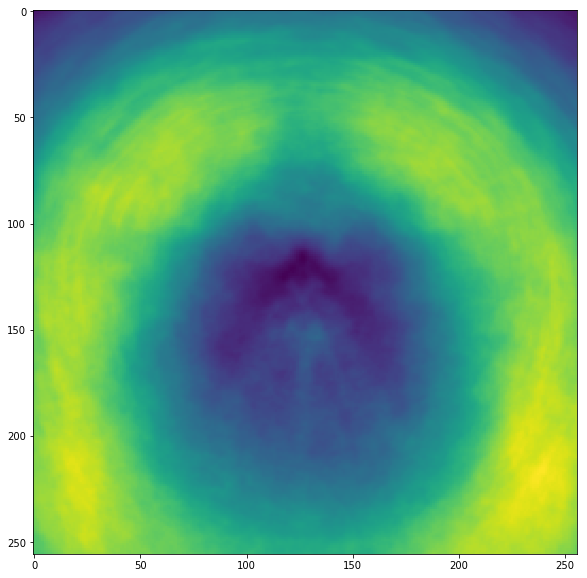

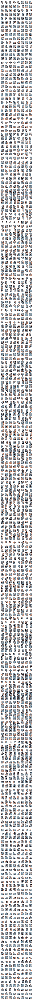

In [6]:
with h5py.File(h5_lf_vis_file_loc, 'r') as h5_file:
    print("File keys : {}".format(list(h5_file.keys())))
    all_images = h5_file['images']
    print("Images : {} {}".format(all_images.shape, all_images.dtype))
    sample_image = h5_file['images'][250]
    mean = h5_file['mean']
    var = h5_file['var']
    scale = h5_file['scale']
    print("Mean : {} {}".format(mean.shape, mean.dtype))
    print("Std. dev. : {} {}".format(scale.shape, scale.dtype))
    print("Variance : {} {}".format(var.shape, var.dtype))
    print(sample_image.shape, sample_image.dtype)
    plt.rcParams['figure.figsize'] = [10, 10]
    plt.imshow(var[32, 0, :, :])
    plt.show()
    plt.rcParams['figure.figsize'] = [10, 320]
    top_left = all_images[:, 0, :, :, :]
    tot = top_left.shape[0]
    rows = int(math.ceil(tot / 8))
    cols = int(math.ceil(tot  / rows))
    f, axes = plt.subplots(rows, cols)
    for y, row_axis in enumerate(axes):
        for x, col_axis in enumerate(row_axis):
            image = top_left[(y * cols) + x]
            # [C, H, W] -> [H, w, C]
            # Seems to be equivalent to moving axis -1 to -3
            image = np.moveaxis(image, 0, 2)
            col_axis.imshow(image)
            col_axis.axis('off')
            col_axis.get_xaxis().set_visible(False)
            col_axis.get_yaxis().set_visible(False)
    plt.show()

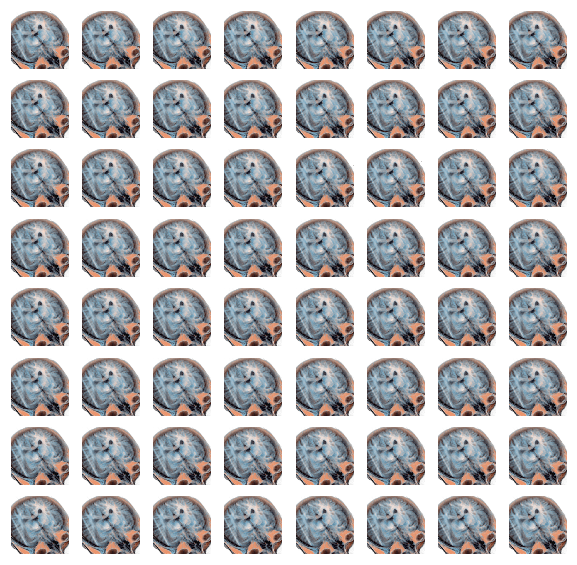

In [7]:
plt.rcParams['figure.figsize'] = [10, 10]
f, axes = plt.subplots(8, 8)
for y, row_axis in enumerate(axes):
    for x, col_axis in enumerate(row_axis):
        image = sample_image[(y * 8) + x]
        # [C, H, W] -> [H, w, C]
        # Seems to be equivalent to moving axis -1 to -3
        image = np.moveaxis(image, 0, 2)
        col_axis.imshow(image)
        col_axis.axis('off')
        col_axis.get_xaxis().set_visible(False)
        col_axis.get_yaxis().set_visible(False)
plt.show()

It is diffcult to see if the images are in fact different from above visualisation, need to validate.

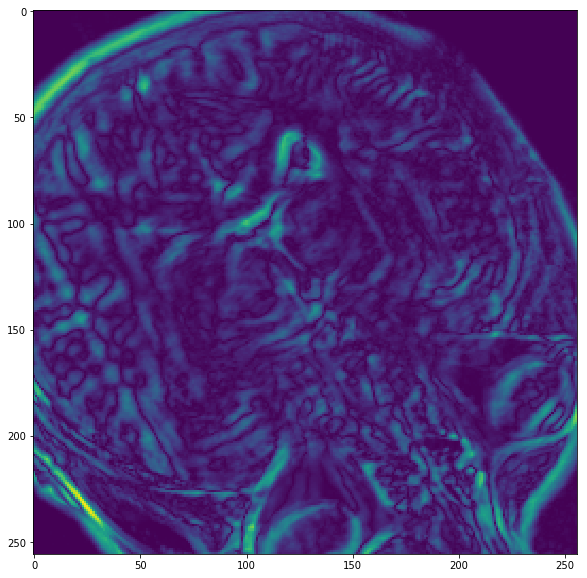

In [8]:
diff_image = sample_image[63].astype(np.float32) - sample_image[0].astype(np.float32)
diff_image = np.moveaxis(diff_image, -3, -1)
diff_image = np.squeeze(np.linalg.norm(diff_image, axis=-1))
plt.imshow(diff_image)

In [9]:
%who

all_images	 axes	 base_dir	 col_axis	 cols	 diff_image	 f	 h5_file	 h5_lf_vis_file_loc	 
h5py	 home	 image	 math	 mean	 mri_head_vol_file_loc	 np	 os	 path_args	 
plt	 row_axis	 rows	 sample_image	 scale	 seaborn	 top_left	 tot	 var	 
x	 y	 


The MRI data is also available to us, can visualise slices to inspect the data.

(256, 256)
MRI slice : (256, 256) uint8


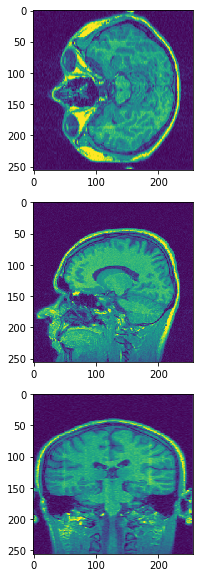

In [10]:
# Visualize the head volume data
plt.rcParams['figure.figsize'] = [100, 10]
mri_head_vol = np.load(mri_head_vol_file_loc)
slice_x, slice_y, slice_z = 150, 150, 150
mri_slices = [mri_head_vol[slice_x, :, :],  
              mri_head_vol[:, slice_y, :],  
              mri_head_vol[:, :, slice_z]]
print(mri_slices[0].shape)
mri_slices = [np.squeeze(mris) for mris in mri_slices]
print("MRI slice : {} {}".format(mri_slices[0].shape, mri_slices[0].dtype))

f, axes = plt.subplots(3)
for idx, row_axis in enumerate(axes):
    row_axis.imshow(mri_slices[idx])
plt.show()